# Undervalued ZIP Codes of Silicon Valley

### What are the "undervalued" ZIP Codes of Silicon Valley which represent potential opportunities for investment in apartment buildings?

In this analysis, ZIP Codes covering the core (sub)urban area of Santa Clara County (better known as Silicon Valley) are clustered based on venue category frequencies derived from Foursquare venue data. The distribution of ZIP Code Fair Market Rent (FMR) is examined among these clusters, revealing several promising "undervalued" ZIP Codes. These are ZIP Codes which have the venue category mix of more expensive neighborhoods, but which themselves are are less expensive. They may represent areas on the rise and hence good investments in apartment buildings.

**Please note that Folium maps will not render on GitHub. Kindly paste the link to this notebook into <a href="https://nbviewer.jupyter.org/">NB Viewer</a> to see the maps. Alternatively, the maps are visible in the pdfs of the report and slide presentation which accompany this notebook. Thank you!**

## Contents

1. Setting the Scene: ZIP Codes of Santa Clara County
2. Rent Data by ZIP Code
3. Venue Category Data by ZIP Code
4. K-Means Clustering of ZIP Codes
5. Clusters vs. Rent
6. Conclusions

In [1]:
# Import required libraries.

# Handling requests and processing returned json files
import requests
import json

# Data wrangling
import pandas as pd
import numpy as np

# Mapping and geocoding
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors
from geopy.geocoders import Nominatim

# General plotting
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

# Clustering
from sklearn.cluster import KMeans

# Kruskal-Wallis H stest for equal means
from scipy.stats import kruskal

## 1. Setting the Scene: ZIP Codes of Santa Clara County

The first step is to identify the ZIP Codes of the core (sub)urban area of Santa Clara County, California and map them.

Centering the map on the geographic center of the county is less than ideal, as there is a lot of rural area to the south and east of the (sub)urban core. I have chosen to center the map instead on the city of San Jose.

In [2]:
# Use the Nominatim geocoder to retrieve the coordinates of San Jose.

geolocator = Nominatim(user_agent="scc_explorer")
location = geolocator.geocode("San Jose, CA")
latitude = location.latitude
longitude = location.longitude

print("San Jose is centered at", latitude, longitude)

San Jose is centered at 37.3361905 -121.890583


The next task is to obtain a GeoJSON polygon file with the ZIP Code boundaries. The City of San Jose's Enterprise GIS department provides one for download. More information can be found <a href="https://data.sanjoseca.gov/dataset/zip-code-boundary1/resource/cde0aa77-a995-4457-b6d1-6449c0274bfa">here</a>. Note that this file includes ZIP Codes not only within San Jose but the rest of Santa Clara County as well.

In [9]:
# Get the GeoJSON file.

url = "https://gisdata-csj.opendata.arcgis.com/datasets/a8ba452a1cb546d69a1c31f9e2d439f2_181.geojson?outSR=%7B%22latestWkid%22%3A2227%2C%22wkid%22%3A102643%7D"
zipcodes = requests.get(url).json()

In [4]:
# Map the ZIP Codes with Folium.

scc_map = folium.Map(location=[latitude, longitude], zoom_start=10, control_scale=True)

folium.GeoJson(zipcodes, name="geojson").add_to(scc_map)

scc_map

In [5]:
# Determine the structure of each ZIP Code in the GeoJSON.

zipcodes["features"][0]["properties"]

{'OBJECTID': 2404,
 'ZIPCODE': '94022',
 'LASTUPDATE': '2020-10-09T23:26:11Z',
 'SANJOSELIMITS': 'No',
 'SHAPE_Length': 138050.84609952886,
 'SHAPE_Area': 495658414.5016506}

In [6]:
# Extract of list of ZIP Codes.

zips = [zipcode["properties"]["ZIPCODE"] for zipcode in zipcodes["features"]]
print(zips)

['94022', '94024', '94035', '94040', '94041', '94043', '94085', '94086', '94087', '94089', '94301', '94304', '94305', '94306', '94550', '95002', '95008', '95013', '95014', '95020', '95030', '95033', '95035', '95037', '95046', '95050', '95051', '95053', '95054', '95070', '95076', '95111', '95113', '95116', '95117', '95118', '95119', '95120', '95121', '95122', '95123', '95124', '95125', '95126', '95127', '95128', '95129', '95130', '95131', '95132', '95133', '95134', '95135', '95136', '95138', '95139', '95140', '95141', '95148', '95192', '94028', '94303', '95023', '95032', '95110', '95112']


In [7]:
len(zips)

66

I decided to exclude three ZIP Codes from this list: 95076, 94550, and 95023. 95076 is mainly in Santa Cruz County. The main city of 94550, Livermore, is in Alameda County. The main city of 95023, Hollister, is in San Benito County.

In [8]:
zips = [z for z in zips if z not in ["94550", "95076", "95023"]]
print(zips)

['94022', '94024', '94035', '94040', '94041', '94043', '94085', '94086', '94087', '94089', '94301', '94304', '94305', '94306', '95002', '95008', '95013', '95014', '95020', '95030', '95033', '95035', '95037', '95046', '95050', '95051', '95053', '95054', '95070', '95111', '95113', '95116', '95117', '95118', '95119', '95120', '95121', '95122', '95123', '95124', '95125', '95126', '95127', '95128', '95129', '95130', '95131', '95132', '95133', '95134', '95135', '95136', '95138', '95139', '95140', '95141', '95148', '95192', '94028', '94303', '95032', '95110', '95112']


In [9]:
len(zips)

63

This list of ZIP Codes will be used below to extract relevant rent and venue category data.

## 2. Rent Data by ZIP Code

As this analysis explores the relationship between ZIP Code venue category mix and rent, a reliable and consistent measure of rent is required. Many apartment rental sites offer data based on their own listings, but these may not be consistent from site to site. I chose to use the US Department of Housing and Urban Development (HUD) small area Fair Market Rent (FMR) data. The FMR is set at the 40th percentile of rent distribution and is used to determine values for Section 8 housing vouchers. Small area refers to the fact that this data is defined at the level of ZIP Codes instead of counties. FMRs are set separately for apartments of different sizes. I have chosen to use the one bedroom apartment data. More information is available <a href="https://www.huduser.gov/portal/datasets/fmr/smallarea/index.html">here</a>.

If one were trying to get a realistic idea of rent in Santa Clara County, the 40th percentile may not be ideal. However, the goal of this analysis is to compare the *relative* cost of rent from ZIP Code to ZIP Code to venue category mix. The consistency and accuracy of the HUD data makes it an attractive choice for this purpose.

In [10]:
# Load the small area FMR excel file into a DataFrame.

url = "https://www.huduser.gov/portal/datasets/fmr/fmr2021/fy2021_safmrs_revised.xlsx"
fmr_data = pd.read_excel(url)
fmr_data.head()

,ZIP\nCode,HUD Area Code,HUD Metro Fair Market Rent Area Name,SAFMR\n0BR,SAFMR\n0BR -\n90%\nPayment\nStandard,SAFMR\n0BR -\n110%\nPayment\nStandard,SAFMR\n1BR,SAFMR\n1BR -\n90%\nPayment\nStandard,SAFMR\n1BR -\n110%\nPayment\nStandard,SAFMR\n2BR,SAFMR\n2BR -\n90%\nPayment\nStandard,SAFMR\n2BR -\n110%\nPayment\nStandard,SAFMR\n3BR,SAFMR\n3BR -\n90%\nPayment\nStandard,SAFMR\n3BR -\n110%\nPayment\nStandard,SAFMR\n4BR,SAFMR\n4BR -\n90%\nPayment\nStandard,SAFMR\n4BR -\n110%\nPayment\nStandard
0,76437,METRO10180M10180,"Abilene, TX MSA",570,513,627,590,531,649,780,702,858,1030,927,1133,1320,1188,1452
1,76443,METRO10180M10180,"Abilene, TX MSA",580,522,638,600,540,660,780,702,858,1050,945,1155,1340,1206,1474
2,76464,METRO10180M10180,"Abilene, TX MSA",570,513,627,590,531,649,780,702,858,1030,927,1133,1320,1188,1452
3,76469,METRO10180M10180,"Abilene, TX MSA",590,531,649,610,549,671,800,720,880,1080,972,1188,1370,1233,1507
4,79501,METRO10180M10180,"Abilene, TX MSA",700,630,770,720,648,792,940,846,1034,1260,1134,1386,1610,1449,1771


In [11]:
# Save and rename the necessary columns.

fmr_data = fmr_data[["ZIP\nCode", "SAFMR\n1BR"]]
fmr_data = fmr_data.rename(columns={"ZIP\nCode":"zipcode", "SAFMR\n1BR":"fmr1bdrm"})

In [12]:
fmr_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27144 entries, 0 to 27143
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   zipcode   27144 non-null  int64
 1   fmr1bdrm  27144 non-null  int64
dtypes: int64(2)
memory usage: 424.2 KB


Note that the ZIP Code is an integer. It needs to be converted into a string so that the ZIP Code list generated in part 1 can be used to extract the correct rent data.

In [13]:
fmr_data["zipcode"] = fmr_data["zipcode"].astype(str)
fmr_scc = fmr_data.loc[fmr_data["zipcode"].isin(zips)]
fmr_scc = fmr_scc.sort_values("zipcode").reset_index(drop=True)
fmr_scc.head()

,zipcode,fmr1bdrm
0,94022,3620
1,94024,3650
2,94028,3230
3,94028,3230
4,94035,2560


In [14]:
# Compare number of rows to number of ZIP Codes.

print(fmr_scc.shape[0], len(zips))

66 63


It seems there are a few extra lines of rent data. For example, it can be seen above that there are two lines for 94028. Upon closer inspection, it turns out there are a few ZIP Codes which straddle both the San Francisco and San Jose Metro areas and so are included twice.

In [15]:
fmr_scc = fmr_scc.drop_duplicates()
fmr_scc.shape[0]

62

Oh no! Now I'm missing one.

In [16]:
missing_zipcode = [z for z in zips if z not in set(fmr_scc["zipcode"])]
missing_zipcode

['95192']

I double checked the original excel file from HUD: this ZIP Code, located in downtown San Jose is strangely missing. I looked up the missing 2021 FMR value on https://www.rentdata.org/lookup?zip=95192. It's 2558. Append that to the DataFrame.

In [17]:
fmr_scc = fmr_scc.append({"zipcode":"95192", "fmr1bdrm":2558}, ignore_index=True)
fmr_scc.tail()

,zipcode,fmr1bdrm
58,95139,3080
59,95140,2440
60,95141,2560
61,95148,3090
62,95192,2558


In [18]:
fmr_scc.shape[0]

63

Just for fun, let's see what we have so far with a nifty choropleth map.

In [19]:
scc_rent_map = folium.Map(location=[latitude, longitude], zoom_start=10, control_scale=True)

folium.Choropleth(
    geo_data=zipcodes,
    name="choropleth",
    data=fmr_scc,
    columns=["zipcode", "fmr1bdrm"],
    key_on="feature.properties.ZIPCODE",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0.1,
    legend_name="One Bedroom Fair Market Rent by Zip Code",
).add_to(scc_rent_map)

scc_rent_map

As someone who has spent some time in Santa Clara County, this passes a sanity check. As I suspected, the most expensive areas are largely on the western side of the valley plus Almaden to the south. The general pattern is the core of San Jose and Campbell is less expensive, surrounded by a ring of posher suburbs, in turn bordered by less expensive rural areas to the south and east. 

In [152]:
# Save the data so far.

fmr_scc.to_csv("fmr_scc.csv", index=False)

## 3. Venue Category Data by ZIP Code

The API provided by Foursquare will be used to extract the categories of venues. This requires latitudes and longitudes for each ZIP Code. What is the center of a ZIP Code? Since ZIP Codes are defined by postal routes rather than boundaries, there seems to be a lot of variation in the answer. 

### 3a. Finding ZIP Code coordinates

I ran the ZIP Code list from part 1 through two geocoders available through the geopy package, Nominatim and ArcGIS. Both successfully returned coordinate lists, but when plotted on the map with the ZIP Code overlay, they did not well represent the population centers of many ZIP Codes. I've included the results from Nominatim below to give an idea of the problem.

In [ ]:
# Using Nominatim to find ZIP Code coordinates...

lats=[]
longs=[]

geolocator = Nominatim(user_agent="scc_explorer")

for z in fmr_scc["zipcode"]:
    zip_location = geolocator.geocode(z+", California")
    lats.append(zip_location.latitude)
    longs.append(zip_location.longitude)

And in testing, I ran through my Nominatim call limit, so I'm pulling the data from a file I saved after running the above code previously. Always save a copy of your work!

In [20]:
temp = pd.read_csv("fmr_scc_nom.csv")
temp.head()

,zipcode,lat,long,fmr1bdrm
0,94022,37.384430,-122.113246,3620
1,94024,37.355731,-122.087867,3650
2,94028,37.396055,-122.196583,3230
3,94035,37.423556,-122.040658,2560
4,94040,37.388118,-122.091499,3140


In [21]:
# Mapping the Nominatim ZIP Code coordinates.

scc_rent_map2 = folium.Map(location=[latitude, longitude], zoom_start=10, control_scale=True)

folium.Choropleth(
    geo_data=zipcodes,
    name="choropleth",
    data=fmr_scc,
    columns=["zipcode", "fmr1bdrm"],
    key_on="feature.properties.ZIPCODE",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0.1,
    legend_name="One Bedroom Fair Market Rent by Zip Code",
).add_to(scc_rent_map2)

for index, row in fmr_scc.iterrows():
    text = row["zipcode"] + " $" + str(row["fmr1bdrm"])
    folium.CircleMarker(
        [temp.loc[index, "lat"], temp.loc[index, "long"]],
        radius=5,
        popup=folium.Popup(text, parse_html=True),
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.8,
        parse_html=False
    ).add_to(scc_rent_map2)  

scc_rent_map2

As you can see, some ZIP Code coordinates returned by Nominatim landed in neighboring ZIP Codes. This won't do for using these coordinates for Foursquare API calls. The results from ArcGIS were similar.

After a bit of research, I discovered that the US Census ZIP Code Tabulation Areas (ZCTAs) are better defined. Geonames.org provides a convenient tab-delimited text file containing ZCTA coordinates extracted from the Census data. The zip file is available <a href="https://download.geonames.org/export/zip/">here</a>. Since it's a zip file, I downloaded it locally and unzipped before reading it into a DataFrame.

In [22]:
ziploc = pd.read_csv("US.txt", sep='\t', header=None)
    # My apologies to S. C. Johnson & Son, makers of ziploc bags, for the horrible pun.
ziploc.head()

,0,1,2,3,4,5,6,7,8,9,10,11
0,US,99553,Akutan,Alaska,AK,Aleutians East,13.0,NaN,NaN,54.1430,-165.7854,1.0
1,US,99571,Cold Bay,Alaska,AK,Aleutians East,13.0,NaN,NaN,55.1858,-162.7211,1.0
2,US,99583,False Pass,Alaska,AK,Aleutians East,13.0,NaN,NaN,54.8542,-163.4113,1.0
3,US,99612,King Cove,Alaska,AK,Aleutians East,13.0,NaN,NaN,55.0628,-162.3056,1.0
4,US,99661,Sand Point,Alaska,AK,Aleutians East,13.0,NaN,NaN,55.3192,-160.4914,1.0


In [23]:
ziploc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41483 entries, 0 to 41482
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       41483 non-null  object 
 1   1       41483 non-null  int64  
 2   2       41483 non-null  object 
 3   3       40970 non-null  object 
 4   4       40972 non-null  object 
 5   5       40972 non-null  object 
 6   6       40972 non-null  float64
 7   7       1 non-null      object 
 8   8       1 non-null      float64
 9   9       41483 non-null  float64
 10  10      41483 non-null  float64
 11  11      40951 non-null  float64
dtypes: float64(5), int64(1), object(6)
memory usage: 3.8+ MB


In [24]:
# Extract desired columns and rename them.

ziploc=ziploc[[1, 9, 10]]
ziploc = ziploc.rename(columns={1:"zipcode", 9:"lat", 10:"long"})
ziploc.head()

,zipcode,lat,long
0,99553,54.1430,-165.7854
1,99571,55.1858,-162.7211
2,99583,54.8542,-163.4113
3,99612,55.0628,-162.3056
4,99661,55.3192,-160.4914


In [25]:
# Convert ZIP Code to string it can be merged with the rent data.

ziploc["zipcode"] = ziploc["zipcode"].astype(str)
ziploc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41483 entries, 0 to 41482
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   zipcode  41483 non-null  object 
 1   lat      41483 non-null  float64
 2   long     41483 non-null  float64
dtypes: float64(2), object(1)
memory usage: 972.4+ KB


In [26]:
# Now merge! Left join, as I only want lat and long for ZIP Codes in the rent DataFrame.

scc = pd.merge(fmr_scc, ziploc, how="left", on="zipcode")
scc.head()

,zipcode,fmr1bdrm,lat,long
0,94022,3620,37.3814,-122.1258
1,94024,3650,37.3547,-122.0862
2,94028,3230,37.3702,-122.2182
3,94035,2560,37.3861,-122.0839
4,94040,3140,37.3855,-122.0880


In [27]:
scc.shape[0] # Just checking no ZIP Codes were lost in this process.

63

And now to see the result on the map!

In [28]:
scc_rent_map3 = folium.Map(location=[latitude, longitude], zoom_start=10, control_scale=True)

folium.Choropleth(
    geo_data=zipcodes,
    name="choropleth",
    data=scc,
    columns=["zipcode", "fmr1bdrm"],
    key_on="feature.properties.ZIPCODE",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0.1,
    legend_name="One Bedroom Fair Market Rent by Zip Code",
).add_to(scc_rent_map3)

for index, row in scc.iterrows():
    text = row["zipcode"] + " $" + str(row["fmr1bdrm"])
    folium.CircleMarker(
        [row["lat"], row["long"]],
        radius=5,
        popup=folium.Popup(text, parse_html=True),
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.8,
        parse_html=False
    ).add_to(scc_rent_map3)  

scc_rent_map3

Not bad. I like that the centers are not at the geographical centers but in the functional centers. Take, for example, Cupertino on the western side of the valley. Its ZIP Code extends well into the Santa Cruz Mountains to the west, but the coordinates place the "center" closer to the where most of the population and venues are. A couple of the ZIP Codes on the northwest edge seem a bit off, but this is due to the fact that parts of those ZIP Codes extend outside of Santa Clara County. I don't think that will affect the venue data much. Onward!

In [151]:
# Save the data so far
scc.to_csv("scc.csv", index=False)

### 3b. Retrieving ZIP Code venue data with Foursquare

Foursquare's API offers several endpoints, one of which is explore. This takes a latitude, longitude, radius (in meters) and returns a response containing up to 100 recommended venues with their names, locations, and categories. The venue category data is by nature categorical and is well-suited to clustering analysis. The goal is to identify clusters of ZIP Codes with similar mixes of venue categories. But first some API calls...

In [31]:
CLIENT_ID = "CENSORED"
CLIENT_SECRET = "CENSORED"
VERSION = "20180605" # API version
LIMIT = 100 # Number of venues to be returned per API call.

Setting the radius is a bit of an art. Too small and you risk not returning very many venues or not getting a representative sample of venues. Too big and search areas for different ZIP Codes start to overlap significantly. Most of the valley is suburban sprawl, so the optimal radius is going to be bigger than for truly urban areas with higher venue density and smaller ZIP Codes.

I'm starting with 1 kilometer (1000 meters). 

In [164]:
RADIUS = 1000

To get a sense of the data, let's do a trial call on a medium-sized ZIP Code, say 95124.

In [172]:
test_lat = scc.loc[fmr_scc["zipcode"] == "95124", "lat"].values[0]
test_long = scc.loc[fmr_scc["zipcode"] == "95124", "long"].values[0]
print(test_lat, test_long)

37.2563 -121.9229


In [174]:
url = "https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}".format(
    CLIENT_ID, CLIENT_SECRET, test_lat, test_long, VERSION, RADIUS, LIMIT)

test_results = requests.get(url).json()

In [175]:
# How many venues were returned?

len(test_results["response"]["groups"][0]["items"])

49

Hmm. We could do better. Let's try a bigger radius.

In [179]:
RADIUS = 1250

In [180]:
url = "https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}".format(
    CLIENT_ID, CLIENT_SECRET, test_lat, test_long, VERSION, RADIUS, LIMIT)

test_results = requests.get(url).json()
len(test_results["response"]["groups"][0]["items"])

81

In [34]:
RADIUS = 1500

In [182]:
url = "https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}".format(
    CLIENT_ID, CLIENT_SECRET, test_lat, test_long, VERSION, RADIUS, LIMIT)

test_results = requests.get(url).json()
len(test_results["response"]["groups"][0]["items"])

100

Looking at the map, it appears that for the vast majority of ZIP Codes, a 1500 meter radius will stay mostly inside the ZIP Code. Let's use that. Next, let's understand better what the response looks like.

In [183]:
# Look at the structure of the first result.

test_results["response"]["groups"][0]["items"][0]

{'reasons': {'count': 0,
  'items': [{'summary': 'This spot is popular',
    'type': 'general',
    'reasonName': 'globalInteractionReason'}]},
 'venue': {'id': '4e278ec2b61c9d28cbec4c33',
  'name': 'Pink Beauty & Spa',
  'location': {'address': '2977 Union Ave',
   'crossStreet': 'Foxworthy',
   'lat': 37.26138658007297,
   'lng': -121.9257221536735,
   'labeledLatLngs': [{'label': 'display',
     'lat': 37.26138658007297,
     'lng': -121.9257221536735}],
   'distance': 618,
   'postalCode': '95124',
   'cc': 'US',
   'city': 'San Jose',
   'state': 'CA',
   'country': 'United States',
   'formattedAddress': ['2977 Union Ave (Foxworthy)',
    'San Jose, CA 95124',
    'United States']},
  'categories': [{'id': '4bf58dd8d48988d1ed941735',
    'name': 'Spa',
    'pluralName': 'Spas',
    'shortName': 'Spa',
    'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/spa_',
     'suffix': '.png'},
    'primary': True}],
  'photos': {'count': 0, 'groups': []}},
 'referralId': 'e

We need to extract the category. It's at ["venue"] ["categories"] [0] ["name"] for each item.

In [186]:
# Flatten the JSON
test_venues = pd.json_normalize(test_results["response"]["groups"][0]["items"]) 

# Filter to keep only the necessary columns
test_venues = test_venues[["venue.name", "venue.categories", "venue.location.lat", "venue.location.lng"]]

# Rename columns to just the last word of the column name
test_venues.columns = [col.split(".")[-1] for col in test_venues]

# Extract categories
test_venues["categories"] = test_venues["categories"].apply(lambda x: x[0]["name"])

test_venues.head()

,name,categories,lat,lng
0,Pink Beauty & Spa,Spa,37.261387,-121.925722
1,BevMo!,Liquor Store,37.261419,-121.928460
2,House Of Phó,Vietnamese Restaurant,37.261452,-121.920705
3,Vivian's Nail Bar,Nail Salon,37.261344,-121.924416
4,Cask & Flask Liquors,Liquor Store,37.261289,-121.922664


Nice! Now that seems to be working for one ZIP Code, it's time to do them all.

In [36]:
# This function is adapted from course materials from IBM's Data Science Capstone course.
# It returns a DataFrame with nearby venue information for a list of locations.

def getNearbyVenues(names, latitudes, longitudes, radius):
    
    venues_list=[]
    
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name, end=" ") # So I have something to look at while the API calls are happening...
            
        # Create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # Make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # Return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['zipcode', 
                  'zip_lat', 
                  'zip_long', 
                  'venue', 
                  'venue_lat', 
                  'venue_long', 
                  'venue_category']
    
    return(nearby_venues)

In [38]:
RADIUS = 1500
scc_venues = getNearbyVenues(names=scc["zipcode"], latitudes=scc["lat"], longitudes=scc["long"], radius=RADIUS)

94022 94024 94028 94035 94040 94041 94043 94085 94086 94087 94089 94301 94303 94304 94305 94306 95002 95008 95013 95014 95020 95030 95032 95033 95035 95037 95046 95050 95051 95053 95054 95070 95110 95111 95112 95113 95116 95117 95118 95119 95120 95121 95122 95123 95124 95125 95126 95127 95128 95129 95130 95131 95132 95133 95134 95135 95136 95138 95139 95140 95141 95148 95192 

In [39]:
scc_venues.head()

,zipcode,zip_lat,zip_long,venue,venue_lat,venue_long,venue_category
0,94022,37.3814,-122.1258,Tin Pot Creamery,37.378643,-122.118322,Ice Cream Shop
1,94022,37.3814,-122.1258,Linden Tree,37.379216,-122.116963,Bookstore
2,94022,37.3814,-122.1258,Manresa Bread,37.379234,-122.117080,Bakery
3,94022,37.3814,-122.1258,Asa,37.379490,-122.116821,Spanish Restaurant
4,94022,37.3814,-122.1258,Satura Cakes,37.378835,-122.115860,Bakery


In [40]:
# Save the data so far because I don't want to have to burn through my API call limit doing this again.

scc_venues.to_csv("scc_venues.csv", index=False)

### 3c. Venue category frequencies for each ZIP Code

The final step before clustering is to transform the raw venue data into a useable feature set for clustering. First, the number of venues returned for each ZIP Code is checked. Second, the venue categories are encoded using on hot encoding. Third, the data is grouped by ZIP Code, and the mean of each category is calculated for each ZIP Code. These values are the percentage of that ZIP Code's venues in each category and therefore will be values between 0 and 1.

In [49]:
print("Total number of venues returned is", scc_venues.shape[0]) 

Total number of venues returned is 4167


In [48]:
print("Number of unique venue categoies is", len(scc_venues["venue_category"].unique()))

Number of unique venue categoies is 339


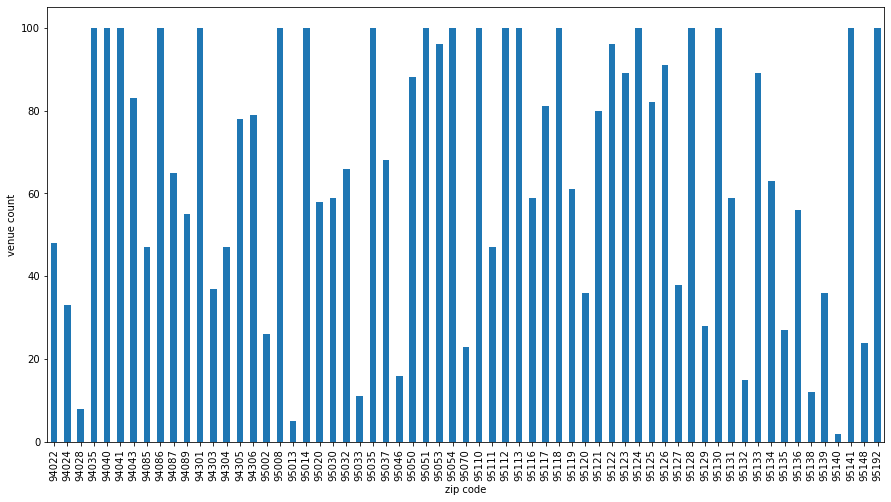

In [47]:
# Visualize number of venues returned for each ZIP Code.

fig, ax = plt.subplots(figsize=(15, 8))
scc_venues.groupby("zipcode")[["venue_category"]].count().plot(kind="bar", legend=False, ax=ax)
ax.set_xlabel("zip code")
ax.set_ylabel("venue count")
plt.show()

In [187]:
# Plug in a ZIP Code to found out how many venues were returned for it.

scc_venues.loc[scc_venues["zipcode"] == "95138"].shape[0]

12

Even with a 1.5 km (1500 meter) radius, not many venues were returned for the more rural ZIP Codes. Unfortunately, if the radius is any bigger than that, the search areas for more urban and suburban ZIP Codes would overlap. 

For the goal of this analysis, it makes sense to drop the low-data ZIP Codes outside of the (sub)urban core. I initially tried clustering including the rural ZIP Codes, and the result was just one big cluster in urban/suburban core and each rural ZIP Code in its own cluster. Not informative! 

I made the decision to toss out 94028, 95013, 95140, all of which have fewer than ten venues. Additionally I decided to toss out 95033, 95037, and 95046 as being too peripheral for this analysis.

In [82]:
zips_to_drop = ["94028", "95013", "95140", "95033", "95037", "95046"]

scc_venues = scc_venues.loc[~scc_venues["zipcode"].isin(zips_to_drop)]
scc_venues.head()

,zipcode,zip_lat,zip_long,venue,venue_lat,venue_long,venue_category
0,94022,37.3814,-122.1258,Tin Pot Creamery,37.378643,-122.118322,Ice Cream Shop
1,94022,37.3814,-122.1258,Linden Tree,37.379216,-122.116963,Bookstore
2,94022,37.3814,-122.1258,Manresa Bread,37.379234,-122.117080,Bakery
3,94022,37.3814,-122.1258,Asa,37.379490,-122.116821,Spanish Restaurant
4,94022,37.3814,-122.1258,Satura Cakes,37.378835,-122.115860,Bakery


In [83]:
# I started with 63 zipcodes, tossed 6, and so should end up with 57.

len(scc_venues["zipcode"].unique())

57

In [86]:
print("Total number of venues is now", scc_venues.shape[0]) 

Total number of venues is now 4057


In [87]:
print("Number of unique venue categoies is now", len(scc_venues["venue_category"].unique()))

Number of unique venue categoies is now 331


In [84]:
# One hot encoding of venue categories.

scc_onehot = pd.get_dummies(scc_venues[["venue_category"]], prefix="", prefix_sep="")

# Add the ZIP Code column back in.

scc_onehot = pd.concat([scc_venues[["zipcode"]], scc_onehot], axis=1)

scc_onehot.head()

,zipcode,ATM,Accessories Store,Acupuncturist,Afghan Restaurant,Airport Terminal,American Restaurant,Andhra Restaurant,Arcade,Art Gallery,...,Vietnamese Restaurant,Volleyball Court,Warehouse Store,Water Park,Weight Loss Center,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,94022,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,94022,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,94022,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,94022,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,94022,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [85]:
# Data should have 4057 rows (one per venue) and 332 columns (331 unique venue categories plus ZIP Code).

scc_onehot.shape

(4057, 332)

In [88]:
# Now group by ZIP Code and find frequency of each venue category by ZIP Code.

scc_grouped = scc_onehot.groupby("zipcode").mean().reset_index()
scc_grouped.head()

,zipcode,ATM,Accessories Store,Acupuncturist,Afghan Restaurant,Airport Terminal,American Restaurant,Andhra Restaurant,Arcade,Art Gallery,...,Vietnamese Restaurant,Volleyball Court,Warehouse Store,Water Park,Weight Loss Center,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,94022,0.020833,0.0,0.0,0.0,0.0,0.062500,0.0,0.020833,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.020833
1,94024,0.030303,0.0,0.0,0.0,0.0,0.030303,0.0,0.000000,0.0,...,0.030303,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000
2,94035,0.010000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000
3,94040,0.000000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000
4,94041,0.010000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,0.0,...,0.010000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000


In [89]:
# Data should have 57 rows (one per ZIP Code) and still 332 columns (331 unique venue categories plus ZIP Code)

scc_grouped.shape

(57, 332)

## 4. K-Means Clustering of ZIP Codes

K-Means clustering is a simple yet effective unsupervised machine learning algorithm which can be used for many applications. Here different areas of Santa Clara County, as defined by ZIP Codes, are clustered based on the frequency of different venue categories within them. The goal is to identify clusters of ZIP Codes with similar mixes of venue types and, ideally, a similar "feel" to them.

K-Means requires that the number of clusters (k) be set in advance. One way to determine the optimal value for k is to use the "elbow method". Models are created for a range of k values. The inertia (sum of squared distances of each data point to its cluster center) will always go down when the number of clusters increased. However, on a plot of inertia versus k, a point or "elbow" can be identified where the decrease in inertia gained by increasing k starts to flatten out.

In [90]:
X = scc_grouped.drop(columns=["zipcode"])
X.head()

,ATM,Accessories Store,Acupuncturist,Afghan Restaurant,Airport Terminal,American Restaurant,Andhra Restaurant,Arcade,Art Gallery,Art Museum,...,Vietnamese Restaurant,Volleyball Court,Warehouse Store,Water Park,Weight Loss Center,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,0.020833,0.0,0.0,0.0,0.0,0.062500,0.0,0.020833,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.020833
1,0.030303,0.0,0.0,0.0,0.0,0.030303,0.0,0.000000,0.0,0.0,...,0.030303,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000
2,0.010000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000
3,0.000000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000
4,0.010000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,0.0,0.0,...,0.010000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000


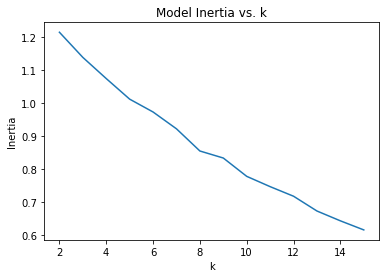

In [98]:
# Create empty list to hold inertia values for models with different values of k.
inertia=[]

max_n = 15

# Try out values of k from 2 to man_n (one cluster is pointless).

for k in np.arange(2, max_n + 1):
    model = KMeans(init="k-means++", n_clusters=k, n_init=12, random_state=42)
    model.fit(X)
    inertia.append(model.inertia_)

# Plot model inertia versus k

plt.plot(np.arange(2, max_n + 1), inertia)
plt.title("Model Inertia vs. k")
plt.xlabel("k")
plt.ylabel("Inertia")
plt.show()

The elbow appears to be at k = 8. Let's use that to build the final model and add the resulting labels to the DataFrame.

In [99]:
k = 8

In [100]:
model = KMeans(init="k-means++", n_clusters=k, n_init=12, random_state=42)
model.fit(X)
labels = model.labels_
scc_grouped.insert(1, "label", model.labels_)
scc_grouped.head()

,zipcode,label,ATM,Accessories Store,Acupuncturist,Afghan Restaurant,Airport Terminal,American Restaurant,Andhra Restaurant,Arcade,...,Vietnamese Restaurant,Volleyball Court,Warehouse Store,Water Park,Weight Loss Center,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,94022,1,0.020833,0.0,0.0,0.0,0.0,0.062500,0.0,0.020833,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.020833
1,94024,1,0.030303,0.0,0.0,0.0,0.0,0.030303,0.0,0.000000,...,0.030303,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000
2,94035,1,0.010000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000
3,94040,1,0.000000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000
4,94041,1,0.010000,0.0,0.0,0.0,0.0,0.010000,0.0,0.000000,...,0.010000,0.0,0.0,0.0,0.0,0.0,0.01,0.0,0.0,0.020000


Merge the ZIP Code coordinates and rent with the cluster labels.

In [101]:
scc_final = pd.merge(scc, scc_grouped[["zipcode", "label"]], how="inner", on="zipcode")
scc_final.head()

,zipcode,fmr1bdrm,lat,long,label
0,94022,3620,37.3814,-122.1258,1
1,94024,3650,37.3547,-122.0862,1
2,94035,2560,37.3861,-122.0839,1
3,94040,3140,37.3855,-122.0880,1
4,94041,2900,37.3893,-122.0783,1


In [199]:
scc_final.shape[0] # Still have all 57 ZIP Codes!

57

In [26]:
# Number of ZIP Codes in each cluster.

scc_final.groupby("label")[["zipcode"]].count().rename(columns={"zipcode":"# of zip codes"}).transpose()

label,0,1,2,3,4,5,6,7
# of zip codes,18,23,6,1,3,1,1,4


Visualize the clusters on the map.

In [141]:
# Set colors for clusters. 

# colors_array = cm.rainbow(np.linspace(0, 1, k))
# cluster_colors = [colors.rgb2hex(i) for i in colors_array]

# I tried out a number of built-in color maps and decided to make a custom one for best cluster visibility:

cluster_colors = ["#ff0000", "#ff9900", "#ffff00", "#bfff00", "#00ff00", "#00ffff", "#0000ff", "#ff00ff"]
cluster_colors

['#ff0000',
 '#ff9900',
 '#ffff00',
 '#bfff00',
 '#00ff00',
 '#00ffff',
 '#0000ff',
 '#ff00ff']

In [172]:
scc_cluster_map = folium.Map(location=[latitude, longitude], zoom_start=10, control_scale=True)

folium.Choropleth(
    geo_data=zipcodes,
    name="choropleth",
    data=scc_final,
    columns=["zipcode", "fmr1bdrm"],
    key_on="feature.properties.ZIPCODE",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0.1,
    legend_name="One Bedroom Fair Market Rent by Zip Code",
).add_to(scc_cluster_map)

for index, row in scc_final.iterrows():
    text = row["zipcode"] + " cluster " + str(row["label"]) + " $" + str(row["fmr1bdrm"])
    folium.CircleMarker(
        [row["lat"], row["long"]],
        radius=5,
        popup=folium.Popup(text, parse_html=True),
        color=cluster_colors[row["label"]],
        fill=True,
        fill_color=cluster_colors[row["label"]],
        fill_opacity=1,
        parse_html=False
    ).add_to(scc_cluster_map)  

scc_cluster_map

That's interesting! There's clearly a downtown San Jose cluster (yellow), with a ring around it (red). The orange cluster predominates on the western side of the valley and the green cluster on the east side. The pink cluster is largely on the north side. The lime green, light blue, and blue clusters are one-offs.

In [143]:
# Save the data

scc_final.to_csv("scc_final.csv", index=False)

Another way to make sense of the clusters is to find the top ten venue categories for each.

In [175]:
# Group the venue category frequency DataFrame by cluster label and take the mean for each venue category frequency.

clusters_grouped = scc_grouped.groupby("label").mean().reset_index()
clusters_grouped.head(8)

,label,ATM,Accessories Store,Acupuncturist,Afghan Restaurant,Airport Terminal,American Restaurant,Andhra Restaurant,Arcade,Art Gallery,...,Vietnamese Restaurant,Volleyball Court,Warehouse Store,Water Park,Weight Loss Center,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,0,0.004540,0.000000,0.000556,0.000000,0.000579,0.011496,0.001513,0.001273,0.000000,...,0.033948,0.000000,0.002076,0.000000,0.001667,0.002069,0.000556,0.005804,0.002222,0.002353
1,1,0.005233,0.000000,0.000000,0.001125,0.000000,0.008643,0.000000,0.001341,0.001890,...,0.006191,0.000000,0.000713,0.000435,0.000000,0.004462,0.003224,0.000000,0.002285,0.008590
2,2,0.000000,0.001832,0.000000,0.000000,0.000000,0.005165,0.000000,0.000000,0.018333,...,0.016832,0.000000,0.000000,0.000000,0.000000,0.003498,0.003333,0.000000,0.000000,0.015165
3,3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.083333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.083333
4,4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.027164,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,5,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000
6,6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.066667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,7,0.000000,0.000000,0.000000,0.000000,0.000000,0.005319,0.000000,0.000000,0.000000,...,0.030146,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004545


In [184]:
# Create a nifty DataFrame with top venue categories for each cluster.
# The code to create the column names is adapted from an exercise in the IBM Data Science Capstone course.

num_top_venues = 10
indicators = ["st", "nd", "rd"]

# Create column list, starting with ZIP Code.
columns = ["label"]

# Add another column name to the list for each top venue place desired.
for i in np.arange(1, num_top_venues + 1): 
    try:
        columns.append(f"{i}{indicators[i-1]} Most Common Venue")
        # Will fail if i is greater than 3 because the index of the last element in indicators is 3.
    except:
        columns.append(f"{i}th Most Common Venue")
        
# Create a new DataFrame.
top_cats = pd.DataFrame(columns=columns)

# Populate the ZIP Code column.
top_cats["label"] = clusters_grouped["label"]

# Populate the top category columns.
for index, row in clusters_grouped.iterrows():
    row = row[1:] # skip first column with ZIP Code
    top_cats.iloc[index, 1:] = row.sort_values(ascending=False).index.values[0:num_top_venues]
    
# Add cluster colors from the map to help make sense of this
color_names = ["red", "orange", "yellow", "lime", "green", "light blue", "blue", "pink"]
top_cats.insert(1, "color", color_names)
    
top_cats.head(8)

,label,color,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,0,red,Coffee Shop,Sandwich Place,Vietnamese Restaurant,Pizza Place,Grocery Store,Fast Food Restaurant,Mexican Restaurant,Convenience Store,Bubble Tea Shop,Chinese Restaurant
1,1,orange,Coffee Shop,Park,Pizza Place,Mexican Restaurant,Grocery Store,Sandwich Place,Chinese Restaurant,Fast Food Restaurant,Gym / Fitness Center,Italian Restaurant
2,2,yellow,Mexican Restaurant,Coffee Shop,Bar,Cocktail Bar,Sandwich Place,Sushi Restaurant,Pub,Pizza Place,Ice Cream Shop,Grocery Store
3,3,lime,Yoga Studio,Hotel,Playground,Seafood Restaurant,Music Venue,Sushi Restaurant,Motel,Gym / Fitness Center,Mexican Restaurant,Baseball Field
4,4,green,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Intersection,Pizza Place,Sandwich Place,Vietnamese Restaurant,Bakery,Video Store,Chinese Restaurant
5,5,light blue,Korean Restaurant,Indian Restaurant,Chinese Restaurant,Coffee Shop,Sushi Restaurant,BBQ Joint,Sandwich Place,Park,Spa,Rental Car Location
6,6,blue,Park,Light Rail Station,Tennis Court,Fried Chicken Joint,Playground,Food & Drink Shop,Bubble Tea Shop,Volleyball Court,Burrito Place,Donut Shop
7,7,pink,Park,Hotel,Food Truck,Mexican Restaurant,Convenience Store,Gym,Indian Restaurant,Vietnamese Restaurant,Video Store,Gym / Fitness Center


Working out from the downtown center:

Cluster 2 (yellow) is the downtown cluster. Venue categories unique to its top ten are bars, cocktail bars, and pubs, indicating this is a key evening entertainment destination.

Cluster 0 (red) is the ring around the downtown cluster. No categories are unique to its top ten. The difference must lie in the assortment of categories outside the top ten or in its relative lack of some of the top categories of the clusters farther from downtown such as parks.

Cluster 1 (orange) mostly follows the curve of the foothills on the west and south of the valley. It has a similar mix as the red ring, with a higher portion of its venues being parks, gyms, and Italian restaurants. A cursory glance at the map above suggests that this area correlates with higher rents. More on that in the next section.

Cluster 4 (green) is on the east side of the valley. If cluster 1 (orange) can be thought of western and southern suburbs, then cluster 4 is the eastern suburbs. Compared to cluster 1, Cluster 4 has a higher portion of its venues being convenience stores, video stores, and bakeries and a lower portion being coffee shops and parks.

Cluster 7 (pink) is mostly on the north of the valley by the bay. I had no idea this is the food truck capital of the valley! This cluster and the single-ZIP Code cluster 5 (light blue, just south of most of the pink cluster) are the only two with Indian restaurants in the top ten categories.

The remaining clusters only have one ZIP Code in them. Cluster 5 (light blue) is 95051 is the only cluster with Korean restaurants in its top ten. Not surprisingly, this area is known as Koreatown. Cluster 6 (blue) is 95132. Only 15 venues were returned for it, and I suspect that the small sample size made this an outlier. Cluster 3 (lime) is 95138. Only 12 venues were returned for it, and I again suspect that the small sample size made this an outlier.

## 5. Clusters vs. Rent

Now for the big questions: How do clusters based on venue category mix relate to rent? And are there any potentially "undervalued" ZIP Codes which have the venue category mix of more expensive areas, but yet are not as expensive themselves?

A first step is to simply look at the mean Fair Market Rent (FMR) for each cluster as well as the distribution of FMRs of each ZIP Code in each cluster.

In [147]:
# FMR descriptive statistics for the dataset as a whole.

scc_final["fmr1bdrm"].describe()

count      57.000000
mean     2748.035088
std       472.222026
min      2220.000000
25%      2310.000000
50%      2640.000000
75%      3080.000000
max      3840.000000
Name: fmr1bdrm, dtype: float64

In [146]:
# Mean FMR by cluster

scc_final_grouped = scc_final.groupby("label")[["fmr1bdrm"]].mean()
scc_final_grouped

,fmr1bdrm
label,
0,2496.666667
1,3024.782609
2,2586.333333
3,3090.000000
4,2223.333333
5,2830.000000
6,2880.000000
7,2785.000000


At first glance, there seems to be decent separation between the mean FMRs of different clusters. The individual ZIP Code FMRs range from 2,220 to 3,840 and the cluster mean FMRs range roughly from 2,223 to 3,090. Let's look into this a bit further and compare the distributions of FMRs for each cluster with a box plot. I've kept the same colors as the markers on the map for clarity.

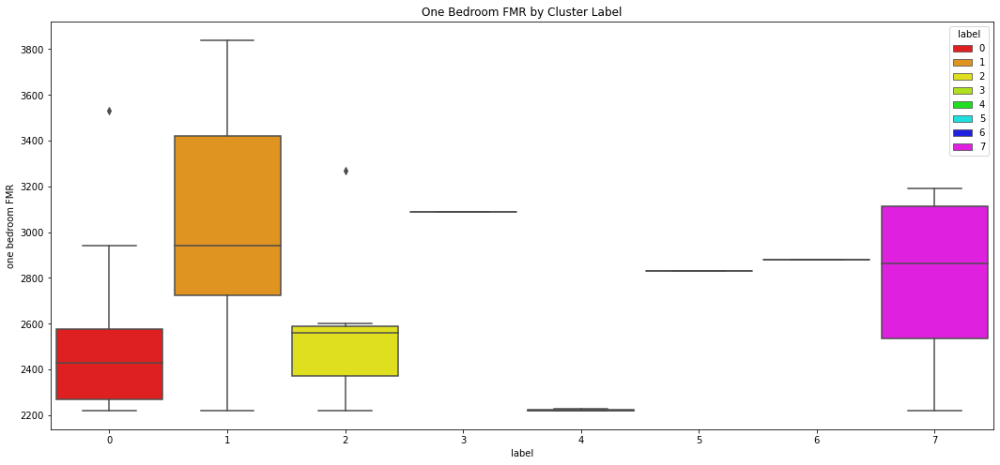

In [205]:
fig, ax = plt.subplots(figsize=(18, 8))
sns.boxplot(x="label", y="fmr1bdrm", hue="label", palette=cluster_colors, width=0.9, dodge=False, data=scc_final, ax=ax)
ax.set_title("One Bedroom FMR by Cluster Label")
ax.set_ylabel("one bedroom FMR")
plt.show()

The distributions are a bit easier to see, perhaps, on a cousin of the box plot, the violin plot:

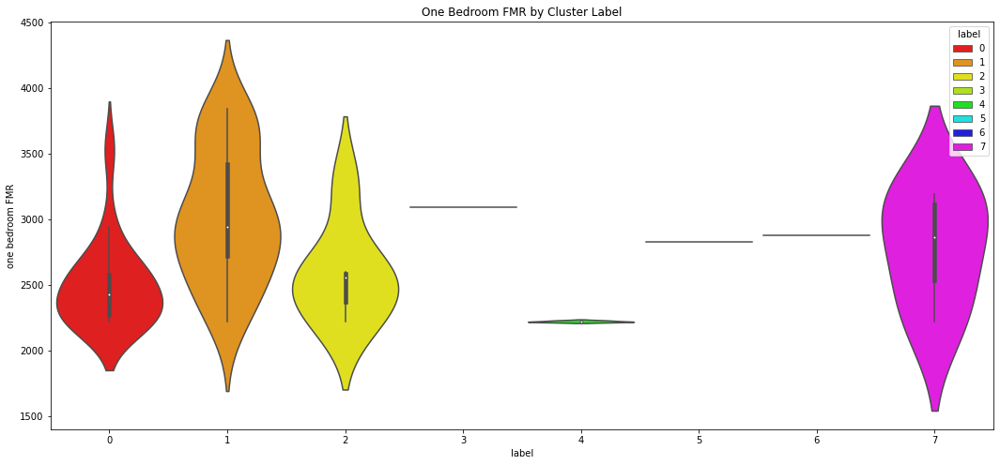

In [206]:
fig, ax = plt.subplots(figsize=(18, 8))
sns.violinplot(x="label", y="fmr1bdrm", hue="label", palette=cluster_colors, width=0.9, dodge=False, data=scc_final, ax=ax)
ax.set_title("One Bedroom FMR by Cluster Label")
ax.set_ylabel("one bedroom FMR")
plt.show()

Recall that clusters 3, 5, and 6 only have one ZIP Code and therefore only one FMR. Cluster 4 has three ZIP Codes, all of which have lower FMRs. On the other hand, cluster 7 has four ZIP Codes, which are spread out over a much wider range. More interesting are the first three clusters: 0 (downtown), 1 (western and southern suburbs), 2 (ring around downtown). Each of these clusters has at least five ZIP Codes. Cluster 1, with more parks, gyms, and Italian restaurants appears more expensive, although notably, it spans the entire FMR range.

We can be more scientific about this and test whether the separation of the cluster means is significant. Since it is obvious from the box plot that the distribution of FMRs within clusters is not normal (it's quite skewed in cluster 0, for example) and the variance of each cluster's FMRs is not the same (cluster 1 has a much bigger spread), a one-way ANOVA F Test is not appropriate. The Kruskal-Wallis H test, however, makes no assumption as to normal distribution nor equal variance. Its sole requirement is that each sample has at least five data points. Let's look at the two largest clusters, 0 (18 ZIP Codes) and 1 (23 ZIP Codes). Is there a significant difference between their mean FMRs? Or in practical terms, is there a meaningful difference in rent between the red ring around the downtown area and the orange band to the west and south?

In [13]:
# Pull out each cluster and extract FMRs into an array.

c0 = scc_final.loc[scc_final["label"] == 0, "fmr1bdrm"].values
c0

array([2670, 2680, 3530, 2220, 2530, 2300, 2300, 2260, 2370, 2570, 2220,
       2530, 2580, 2310, 2220, 2940, 2220, 2490], dtype=int64)

In [14]:
c1 = scc_final.loc[scc_final["label"] == 1, "fmr1bdrm"].values
c1

array([3620, 3650, 2560, 3140, 2900, 2890, 2760, 3040, 3710, 2220, 2940,
       2440, 2770, 2700, 3220, 3840, 2750, 3690, 2320, 2410, 3740, 3180,
       3080], dtype=int64)

In [23]:
H, p = kruskal(c0, c1)
print(f"The H statistic is {H} with a p value of {p}.")

The H statistic is 13.264843677198375 with a p value of 0.00027043000753287005.


With a significance level of 0.05 (95% confidence level), we can reject the null hypothesis that the cluster means are the same with a p value of 0.00027. 

In other words, while cluster membership is not strongly predicative of rent (recall the FMRs of cluster 1 span the entire FMR range), the difference in mean FMR between clusters 0 and 1 is meaningful. This suggests that there are perhaps good opportunities for investment in rental housing in those ZIP Codes of cluster 1 which are not yet expensive but have already attracted the sorts of venues that are associated with higher rent areas. Let's take a look at cluster 1 more closely.

In [27]:
# Pull out cluster 1 with associated data
cluster1 = scc_final.loc[scc_final["label"] == 1, ["zipcode", "fmr1bdrm", "label"]]

# Sort by rent (FMR) ascending.
cluster1 = cluster1.sort_values("fmr1bdrm").reset_index(drop=True)

# From above, there are 23 ZIP Codes in cluster 1.
cluster1.head(23)

,zipcode,fmr1bdrm,label
0,94305,2220,1
1,95125,2320,1
2,95129,2410,1
3,95008,2440,1
4,94035,2560,1
5,95032,2700,1
6,95119,2750,1
7,94086,2760,1
8,95030,2770,1
9,94043,2890,1


In [6]:
# Pull out the five ZIP Codes in cluster 1 with the lowest FMR.

undervalued_zips = cluster1.head(5)["zipcode"].values
undervalued_zips

array(['94305', '95125', '95129', '95008', '94035'], dtype=object)

In [7]:
undervalued = scc_final.loc[scc_final["zipcode"].isin(undervalued_zips)]
undervalued

,zipcode,fmr1bdrm,lat,long,label
2,94035,2560,37.3861,-122.0839,1
13,94305,2220,37.4236,-122.1619,1
16,95008,2440,37.2803,-121.9539,1
40,95125,2320,37.2960,-121.8939,1
44,95129,2410,37.3066,-122.0002,1


In [11]:
undervalued_map = folium.Map(location=[latitude, longitude], zoom_start=10, control_scale=True)

folium.Choropleth(
    geo_data=zipcodes,
    name="choropleth",
    data=scc_final,
    columns=["zipcode", "fmr1bdrm"],
    key_on="feature.properties.ZIPCODE",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0.1,
    legend_name="One Bedroom Fair Market Rent by Zip Code",
).add_to(undervalued_map)

for index, row in undervalued.iterrows():
    text = row["zipcode"]
    folium.CircleMarker(
        [row["lat"], row["long"]],
        radius=5,
        popup=folium.Popup(text, parse_html=True, show=True),
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.8,
        parse_html=False
    ).add_to(undervalued_map)  

undervalued_map

Where are 94305, 95125, 95129, 95008, and 94035? And is there some obvious reason these areas are cheaper despite their parks, gyms, and Italian restaurants?

94305 is the Stanford University campus. Nice place to live. Not a lot of investment opportunities as the land is owned by the University. I suspect the rent is lower because of the subsidized apartments the University has built for its graduate students and faculty.

95125 is Willow Glen. It is known for its cute core shopping/dining area. This is definitely an area worth exploring for rental investment opportunities.

95129 is West San Jose. Sandwiched between the wealthier areas of Saratoga (95070, the most expensive ZIP Code in the entire dataset) and Cupertino (95014), this area may also be a good target for rental investment.

95008 is Campbell. Campbell has put a lot of effort into revitalizing its core shopping/dining area and has the "feel" of a neighborhood on the rise. Again, worth a look.

94035 is limited to Moffett Field, a joint civil-military airport. The lower rents in this ZIP Code seem to be the product of government housing for military families. Like Stanford, this is not a viable area for investment.

## 6. Conclusions

This preliminary analysis of ZIP Codes in the core area of Santa Clara County, California has identified three ZIP Codes which have the venue category mix of areas with more expensive rents but yet themselves have lower rents: 95125 (Willow Glen), 95129 (West San Jose), and 95008 (Campbell).

There may be factors not considered here that bring the rent down in these areas, such as school district. Or there may be limited opportunities due to zoning laws. Further research is needed, but having a short list to investigate will decrease the effort and cost of this further research.

*Alissa McFarlin, June 2021*